# **GEOET - Penman-Monteith FAO la emma** 

| Method's input | Temp | ShortWave | LongWave | Net Radiation | Wind speed | Humidity | Soil flux | Pressure | Leaf area index | Water content |
| --- | --- | --- | --- | --- | --- | --- | --- | ---  | --- | --- |
| Priestley-Taylor | $\checkmark$ | $\times$ | $\times$ | $\checkmark$ | $\times$ | $\times$ | $\checkmark$ | $     \checkmark$  | $\times$ | $\times$ |
| Penman-Monteith FAO | $\checkmark$ | $\times$ | $\times$ | $\checkmark$ | $\checkmark$ | $\checkmark$ | $\checkmark$ | $\checkmark$  | $\times$ | $\checkmark$ |
| Prospero | $\checkmark$ | $\checkmark$ | $\checkmark$ | $\times$ | $\checkmark$ | $\checkmark$ | $\checkmark$ | $\checkmark$  | $\checkmark$ | $\checkmark$ |

### **Component Description**
The GEOET component offers the evapotraspiration formulation of Penman-Monteith [FAO](https://www.fao.org/3/X0490E/x0490e06.htm) model. The original Penman-Monteith equation is:
\begin{equation}
\lambda\ ET = \dfrac{\Delta\cdot (R_{n} - G)+\frac{p_{a}\cdot\ c_{p}(e_{s}-e)}{r_{a}}}{\Delta+\gamma\cdot(1+\frac{r_{s}}{r_{a}})}
\end{equation}
where:
- $\lambda ET$ is the evapotranspiration in [$MJ \cdot m^{2} \cdot day^{−1}$] or [$MJ \cdot m^{2}\cdot h^{−1}$]; 
- $\Delta$ is the slope of the saturation vapor-pressure curve expressed in ($kP_{a}\dot °C^{−1}$); 
- $R_{n}$ is the net radiation expressed in [$MJ \cdot m^{2} \cdot day^{−1}$] or [$MJ \cdot m^{2}\cdot h^{−1}$]; 
- $G$ is the soil heat flux at the soil surface in [$MJ \cdot m^{2} \cdot day^{−1}$] or [$MJ \cdot m^{2}\cdot h^{−1}$]; 
- $\rho_{a}$ is the average density of the air at constant pressure ; 
- $c_{p}$ is the air specific heat;
- $e_{s}$ is the mean saturation vapor-pressure expressed in ($kP_{a}$); 
- $e_{a}$ is the mean actual vapor-pressure; 
- $\gamma$ is the psychometric constant expressed in ($kP_{a} \cdot$ °$C^{−1}$); 
- $r_{s}$ is the surface resistence; 
- $r_{a}$ is the aerodynamic resistance.

The FAO Penman-Monteith method can be derived from the original Penman-Monteith equation and the aerodynamic resistance and surface resistance equations determined by FAO to estimate a reference evapotranspiration:

\begin{equation}
ET_{0}^{FAO} =  K_{s} \cdot K_{c} \cdot \dfrac{0.408\cdot \Delta\cdot (R_{n} - G)+\gamma\cdot u_{2}\cdot(e_{s}-e)\cdot\frac{C_{p}}{T+273}}{\Delta+\gamma\cdot(1+C_{d}\cdot u_{2})}
\end{equation}

With:
\begin{equation}
 G =  \begin{cases}
   G_{morn}\cdot R_{n} \quad daylight\\G_{night}\cdot R_{n} \quad nighttime
   \end{cases} 
\end{equation}
where:
- $ET_{0}$ or $ET$ are expressed in [$mm \cdot day^{−1}$] or [$mm\cdot hour^{−1}$]; 
- $K_{s}$ is the water stress coefficient [-];
- $K_{c}$ is the crop coefficient [-]; [Tabella 12](https://www.fao.org/3/X0490E/x0490e0b.htm)
- $R_{n}$ is the net radiation expressed in [$MJ \cdot m^{2} \cdot day^{−1}$] or [$MJ \cdot m^{2}\cdot h^{−1}$]; 
- $G$ is the soil heat flux at the soil surface in [$MJ \cdot m^{2} \cdot day^{−1}$] or [$MJ \cdot m^{2}\cdot h^{−1}$]; 
- $T$ is the mean daily or hourly air temperature expressed in (°C) ; 
- $u_{2}$ is the wind speed in ($m\cdot s^{−1}$); 
- $e_{s}$ is the mean saturation vapor-pressure expressed in ($kP_{a}$); 
- $e$ is the mean actual vapor-pressure; 
- $\Delta$ is the slope of the saturation vapor-pressure curve expressed in ($kP_{a}\dot °C^{−1}$); 
- $\gamma$ is the psychometric constant expressed in ($kP_{a} \cdot$ °$C^{−1}$); 
- $C_{d}$ is a coefficient equal to 0.34 and $C_{p}$ is a coefficient equal to 900 in the case of a daily time step and equal to 37 in the case of a hourly time step.


### **Detailed Inputs description**
General description
The input file is a .csv file containing a header and one or more time series of input data,
depending on the number of stations involved. Each column of the file is associated to a
different station.
The file must have the following header:
- The first 3 rows with general information such as the date of the creation of the file and the author;
- The fourth and fifth rows contain the IDs of the stations (e.g. station number 8:value 8, ID, ,8);
- The sixth row contains the information about the type of the input data (in thiscase, one column with the date and one column with double values);
- The seventh row specifies the date format (YYYY-MM-dd HH:mm).


- #### **Net radiation**
The net radiation is given in time series of ($W/m^{2}$) values. The conversion from ($W/m^{2}$) to ($MJ\cdot m^{2}$) is automatically done by the component.
- #### **Average wind speed**
The average wind speed is given in time series of (m/s) values.
- #### **Relative humidity**
The relative humidity is given in time series or raster maps of (% ) values.
- #### **Air temperature**
The air temperature is given in time series of (°C) values. The conversion in K is directly done by the component.
- #### **$G_{morn}$**
$G_{morn}$ is the coefficient for the soil heat flux during daylight
- #### **$G_{night}$**
$G_{night}$ is the coefficient for the soil heat flux during nighttime
- #### **Start Date**
Start Date is a string containing the first day of the simulation.

### **Detailed Outputs description**
The output file will have exactly the same heading of the input file. 
- #### **Time series of the latent heat (W/m$^{2}$)**
The simulated output evapotranspiration is given as a time series at a given point. Its units are ($mm \cdot h^{−1}$) or ($mm \cdot day^{−1}$) depending on the temporal resolution chosen by the end-user.
- #### **Time series of the evapotranspiration (mm)**
The simulated output evapotranspiration is given as a time series at a given point. Its units are ($mm \cdot h^{−1}$) or ($mm \cdot day^{−1}$) depending on the temporal resolution chosen by the end-user.

In [1]:
import os
import warnings
import datetime
import warnings
import numpy as np
import pandas as pd
import xarray as xr
from matplotlib import rc
import plotly.express as px
import matplotlib.pyplot as plt
import matplotlib.style as style
import matplotlib.dates as mdates
from IPython.display import Image
from GEOSPACE_Output import*
import plotly.graph_objects as go

In [3]:
oms_project_path = os.path.dirname(os.getcwd())
os.chdir(oms_project_path+'/output/Levico/1')
#os.listdir()

## Read the Penman Monteith FAO output

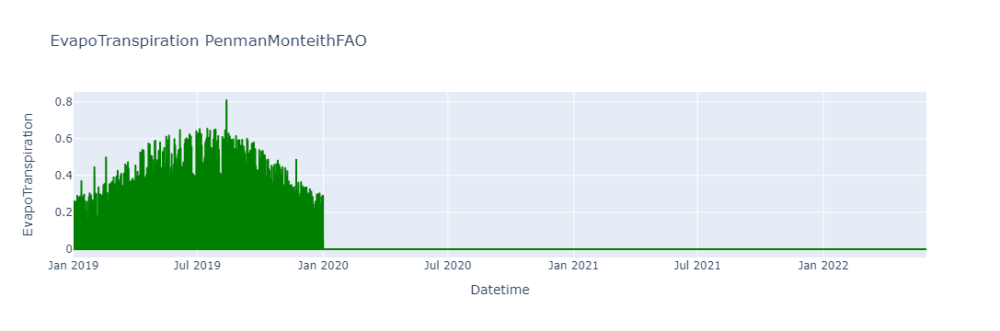

In [4]:
df = pd.read_csv('CI_Evapotranspiration_FAO_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df.columns = ['Datetime','EvapoTranspiration']
fig = px.line(df, x='Datetime', y='EvapoTranspiration', title='EvapoTranspiration PenmanMonteithFAO')
fig.update_traces(line_color='green')
#fig.update_xaxes(rangeslider_visible=True)
fig.show()

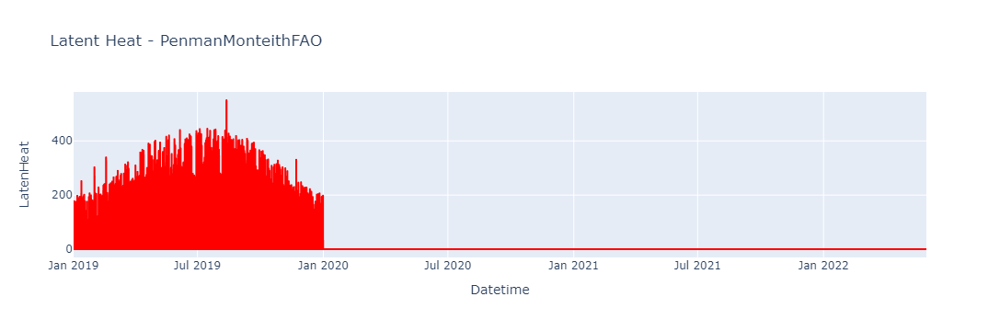

In [6]:
df2 = pd.read_csv('CI_LatentHeat_FAO_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df2.columns = ['Datetime','LatenHeat']
fig = px.line(df2, x='Datetime', y='LatenHeat', title='Latent Heat - PenmanMonteithFAO')
fig.update_traces(line_color='red')
#fig.update_xaxes(rangeslider_visible=True)
fig.show()

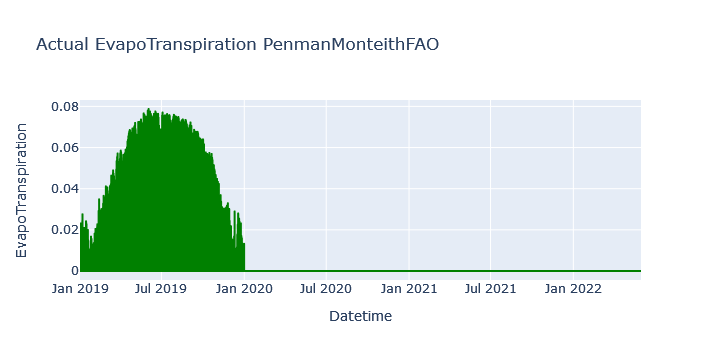

In [7]:
df3 = pd.read_csv('Evapotranspiration_FAO_1_totalstress.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df3.columns = ['Datetime','EvapoTranspiration']
fig = px.line(df3, x='Datetime', y='EvapoTranspiration', title='Actual EvapoTranspiration PenmanMonteithFAO')
fig.update_traces(line_color='green')
#fig.update_xaxes(rangeslider_visible=True)
fig.show()

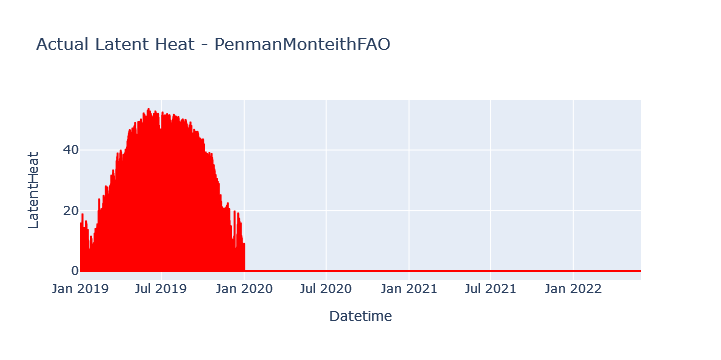

In [9]:
df4 = pd.read_csv('LatentHeat_FAO_1_totalstress.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df4.columns = ['Datetime','LatentHeat']
fig = px.line(df4, x='Datetime', y='LatentHeat', title='Actual Latent Heat - PenmanMonteithFAO')
fig.update_traces(line_color='red')
#fig.update_xaxes(rangeslider_visible=True)
fig.show()

### Comparing Latent Heat with Actual Latent Heat - PMFAO

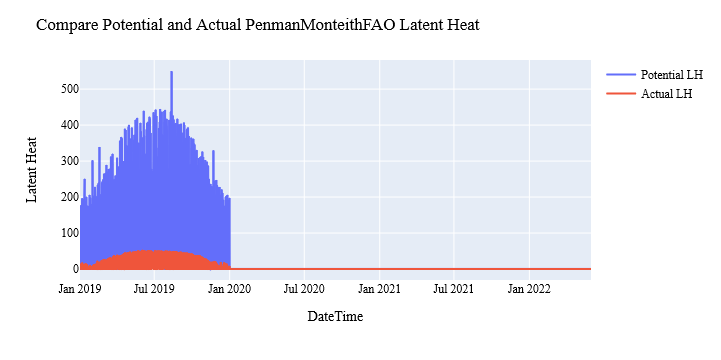

In [11]:
fig1 = px.line()
fig1.add_trace(go.Scatter(x=df2['Datetime'], y=df2['LatenHeat'], mode='lines', name='Potential LH'))
fig1.add_trace(go.Scatter(x=df4['Datetime'], y=df4['LatentHeat'], mode='lines', name='Actual LH'))

fig1.update_layout(
    title='Compare Potential and Actual PenmanMonteithFAO Latent Heat ',
    xaxis_title="DateTime",
    font_family="Times New Roman",
    font_color="Black",
    title_font_family="Times New Roman",
    title_font_color="Black",
    yaxis_title="Latent Heat",
    #legend_title="Date",
    font=dict(size=12))
fig1.show()

### Comparing EvapoTranspiration with Actual - PMFAO

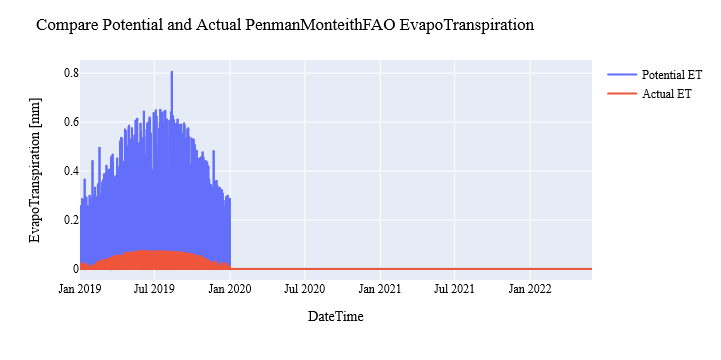

In [12]:
fig = px.line()
fig.add_trace(go.Scatter(x=df['Datetime'], y=df['EvapoTranspiration'], mode='lines', name='Potential ET'))
fig.add_trace(go.Scatter(x=df3['Datetime'], y=df3['EvapoTranspiration'], mode='lines', name='Actual ET'))

fig.update_layout(
    title='Compare Potential and Actual PenmanMonteithFAO EvapoTranspiration ',
    xaxis_title="DateTime",
    font_family="Times New Roman",
    font_color="Black",
    title_font_family="Times New Roman",
    title_font_color="Black",
    yaxis_title="EvapoTranspiration [mm]",
    #legend_title="Date",
    font=dict(size=12))
fig.show()

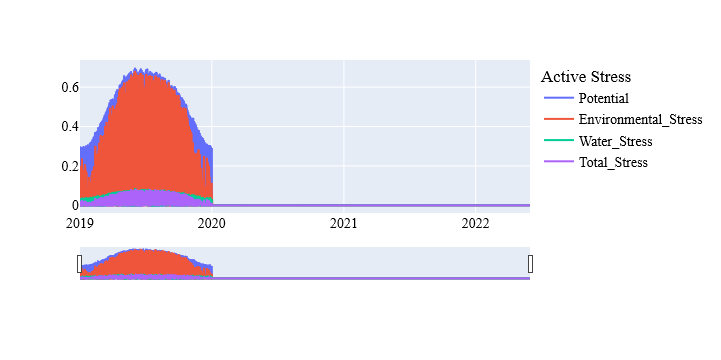

In [13]:
show_stress('Evapotranspiration_FAO_1_potential.csv',
            'Evapotranspiration_FAO_1_environmentalstress.csv',
            'Evapotranspiration_FAO_1_waterstress.csv',
            'Evapotranspiration_FAO_1_totalstress.csv')

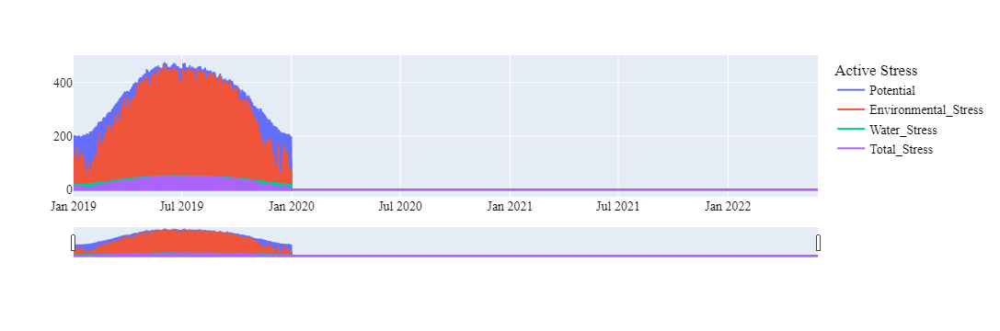

In [14]:
show_stress('LatentHeat_FAO_1_potential.csv',
            'LatentHeat_FAO_1_environmentalstress.csv',
            'LatentHeat_FAO_1_waterstress.csv',
            'LatentHeat_FAO_1_totalstress.csv')